# Initial Data Exploration

In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import librosa
import librosa.display
from IPython.display import Audio, display
import random
import soundfile as sf
from pathlib import Path

In [4]:
# set context
sns.set_context('notebook', font_scale=1.5)

In [7]:
# paths
DATA_DIR = Path('../data/raw')
TRAIN_AUDIO_DIR = DATA_DIR / 'train_audio'
TRAIN_SOUNDSCAPES_DIR = DATA_DIR / 'train_soundscapes'
TRAIN_CSV = DATA_DIR / 'train.csv'
TAXONOMY_CSV = DATA_DIR / 'taxonomy.csv'

## Load and Examine Metadata

In [8]:
print('Loading training metadata...')
train_df = pd.read_csv(TRAIN_CSV)
print(f"Training data shape: {train_df.shape}")

Loading training metadata...
Training data shape: (28564, 13)


In [9]:
# display first few rows
print('First 5 rows of training data:')
display(train_df.head())

First 5 rows of training data:


,primary_label,secondary_labels,type,filename,collection,rating,url,latitude,longitude,scientific_name,common_name,author,license
0,1139490,[''],[''],1139490/CSA36385.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3206,-73.7128,Ragoniella pulchella,Ragoniella pulchella,Fabio A. Sarria-S,cc-by-nc-sa 4.0
1,1139490,[''],[''],1139490/CSA36389.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3206,-73.7128,Ragoniella pulchella,Ragoniella pulchella,Fabio A. Sarria-S,cc-by-nc-sa 4.0
2,1192948,[''],[''],1192948/CSA36358.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3791,-73.7313,Oxyprora surinamensis,Oxyprora surinamensis,Fabio A. Sarria-S,cc-by-nc-sa 4.0
3,1192948,[''],[''],1192948/CSA36366.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.2800,-73.8582,Oxyprora surinamensis,Oxyprora surinamensis,Fabio A. Sarria-S,cc-by-nc-sa 4.0
4,1192948,[''],[''],1192948/CSA36373.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3791,-73.7313,Oxyprora surinamensis,Oxyprora surinamensis,Fabio A. Sarria-S,cc-by-nc-sa 4.0


In [10]:
# basic statistics
print('Basic statistics of training data:')
display(train_df.describe(include='all').T)

Basic statistics of training data:


,count,unique,top,freq,mean,std,min,25%,50%,75%,max
primary_label,28564,206,grekis,990,NaN,NaN,NaN,NaN,NaN,NaN,NaN
secondary_labels,28564,745,[''],25885,NaN,NaN,NaN,NaN,NaN,NaN,NaN
type,28564,736,['song'],9437,NaN,NaN,NaN,NaN,NaN,NaN,NaN
filename,28564,28564,1139490/CSA36385.ogg,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
collection,28564,3,XC,21204,NaN,NaN,NaN,NaN,NaN,NaN,NaN
rating,28564.0,NaN,NaN,NaN,2.917063,1.964896,0.0,0.0,4.0,4.5,5.0
url,28564,28552,https://static.inaturalist.org/sounds/1020465.wav,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN
latitude,27755.0,NaN,NaN,NaN,-0.53348,17.609276,-54.8574,-15.0846,1.1316,9.511,68.3748
longitude,27755.0,NaN,NaN,NaN,-68.52438,21.614566,-163.68,-79.6492,-73.4954,-53.8018,153.5514
scientific_name,28564,206,Pitangus sulphuratus,990,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Examine Taxonomy

In [11]:
print('Loading taxonomy information...')
taxonomy_df = pd.read_csv(TAXONOMY_CSV)
print(f"Taxonomy data shape: {taxonomy_df.shape}")

Loading taxonomy information...
Taxonomy data shape: (206, 5)


In [12]:
# display first few rows
print('First 5 rows of taxonomy data:')
display(taxonomy_df.head())

First 5 rows of taxonomy data:


,primary_label,inat_taxon_id,scientific_name,common_name,class_name
0,1139490,1139490,Ragoniella pulchella,Ragoniella pulchella,Insecta
1,1192948,1192948,Oxyprora surinamensis,Oxyprora surinamensis,Insecta
2,1194042,1194042,Copiphora colombiae,Copiphora colombiae,Insecta
3,126247,126247,Leptodactylus insularum,Spotted Foam-nest Frog,Amphibia
4,1346504,1346504,Neoconocephalus brachypterus,Neoconocephalus brachypterus,Insecta


In [13]:
# species distribution by class
print('Species distribution by taxonomic class:')
class_counts = taxonomy_df['class_name'].value_counts()
display(class_counts)

Species distribution by taxonomic class:


class_name
Aves        146
Amphibia     34
Insecta      17
Mammalia      9
Name: count, dtype: int64

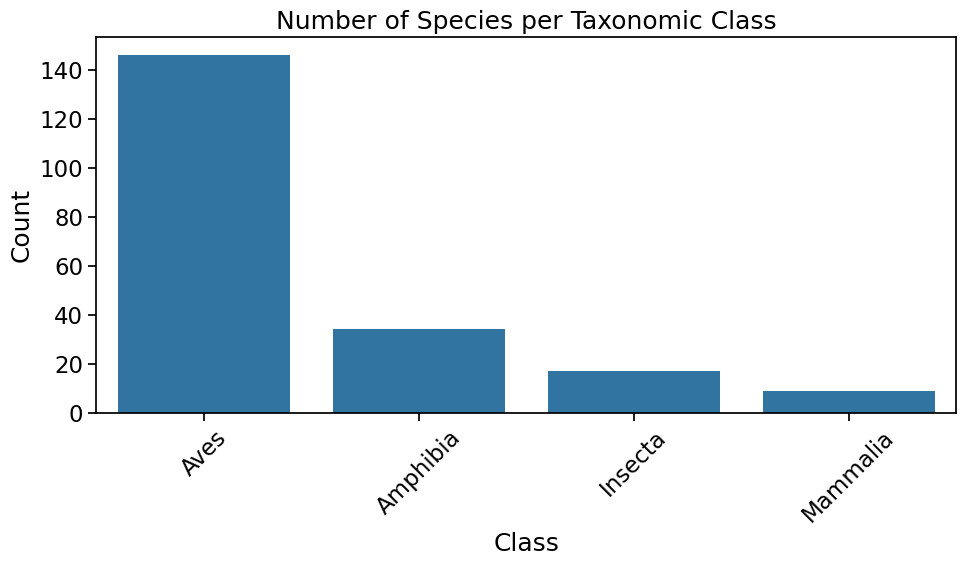

In [14]:
# bar plot of taxonomic classes
plt.figure(figsize=(10, 6))
sns.barplot(x=class_counts.index, y=class_counts.values)
plt.title('Number of Species per Taxonomic Class')
plt.xlabel('Class')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## Audio Samples Analysis

In [15]:
def visualize_audio(audio_path, sr=32000, title=None):
    """Visualize audio file with waveform and spectrogram."""
    plt.figure(figsize=(15, 10))

    # load audio
    try:
        y, sr = librosa.load(audio_path, sr=sr)
    except Exception as e:
        print(f"Error loading {audio_path}: {e}")
        return None
    
    # plot waveform
    plt.subplot(2, 1, 1)
    librosa.display.waveshow(y, sr=sr)
    plt.title(f"Waveform - {title}" if title else 'Waveform')

    # plot spectrogram
    plt.subplot(2, 1, 2)
    D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
    librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Spectrogram')

    plt.tight_layout()
    plt.show()

    # return audio for playback
    return y, sr

In [16]:
# join with taxonomy to get class information
train_with_taxonomy = pd.merge(
    train_df,
    taxonomy_df[['primary_label', 'class_name']],
    on = 'primary_label',
    how = 'left'
)


--- Samples from Insecta ---
Species: Typical Cicadas (Cicadidae)
File: ../data/raw/train_audio/50186/CSA18201.ogg


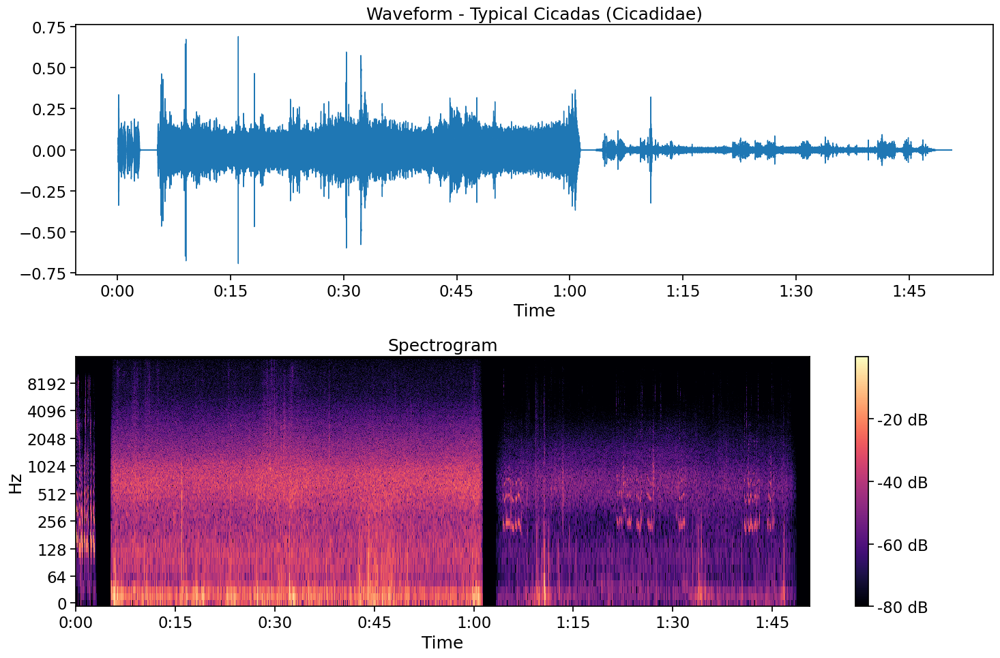

Species: Oxyprora surinamensis (Oxyprora surinamensis)
File: ../data/raw/train_audio/1192948/CSA36358.ogg


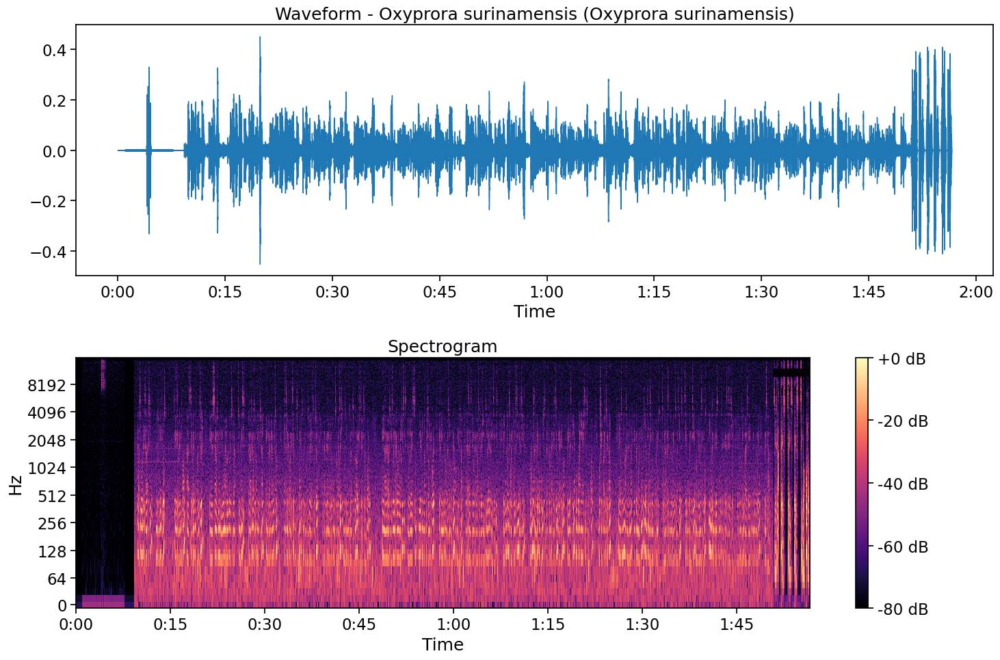


--- Samples from Amphibia ---
Species: Túngara Frog (Engystomops pustulosus)
File: ../data/raw/train_audio/65448/iNat332455.ogg


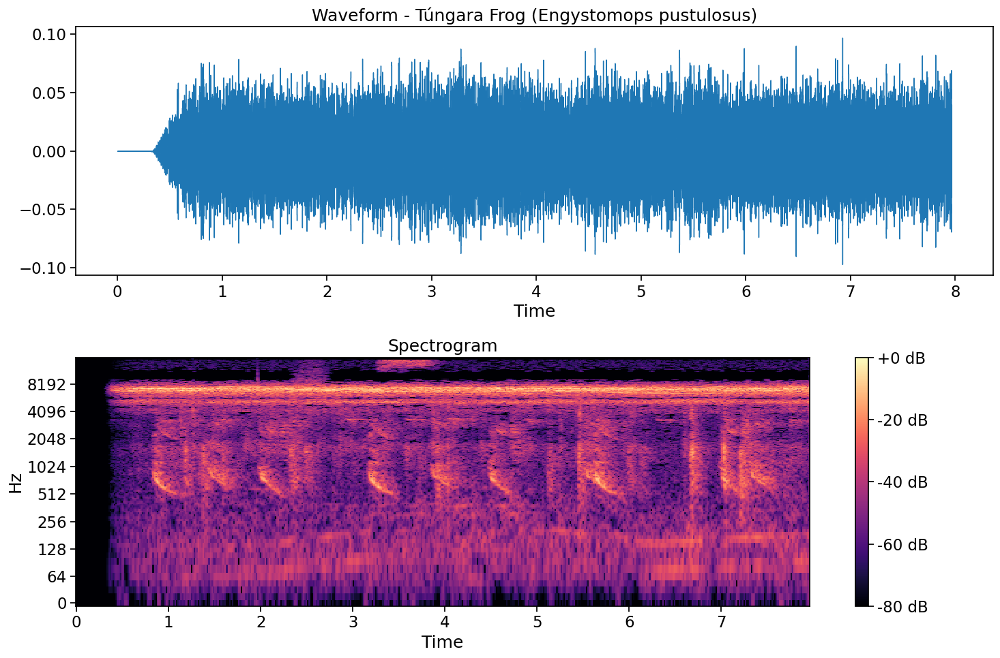

Species: Spotted-thighed Poison Frog (Allobates femoralis)
File: ../data/raw/train_audio/21211/iNat1005762.ogg


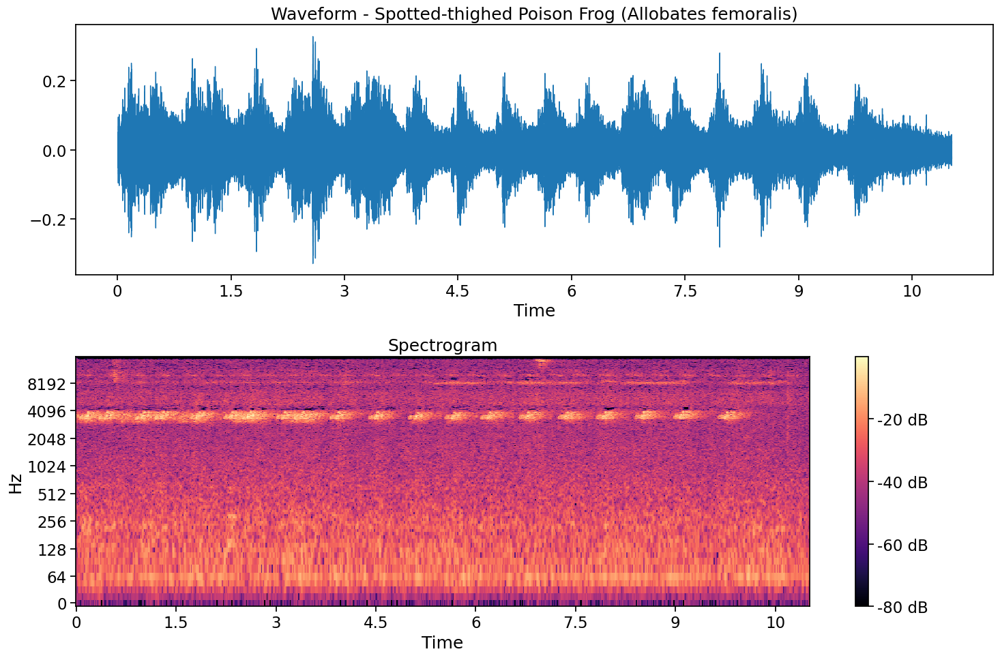


--- Samples from Mammalia ---
Species: Colombian Red Howler Monkey (Alouatta seniculus)
File: ../data/raw/train_audio/566513/iNat208383.ogg


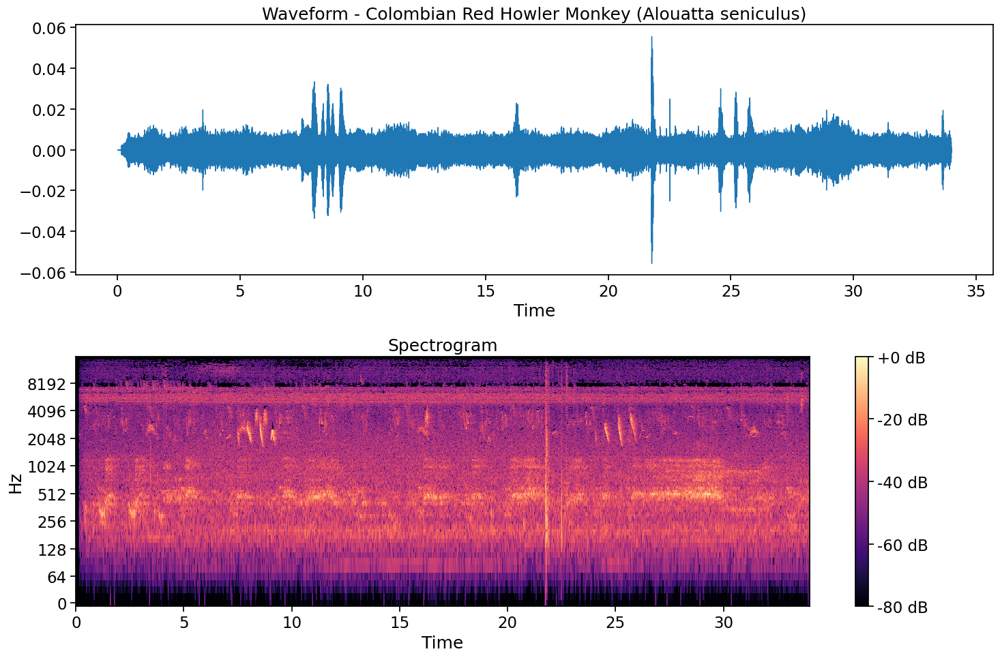

Species: Common Raccoon (Procyon lotor)
File: ../data/raw/train_audio/41663/iNat74629.ogg


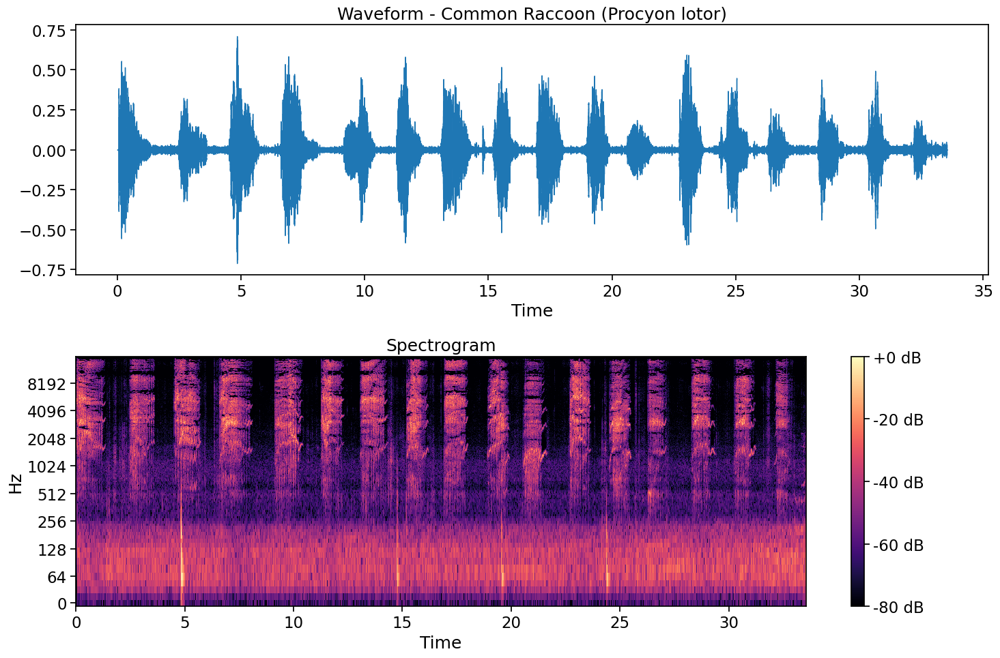


--- Samples from Aves ---
Species: Boat-billed Flycatcher (Megarynchus pitangua)
File: ../data/raw/train_audio/bobfly1/iNat196113.ogg


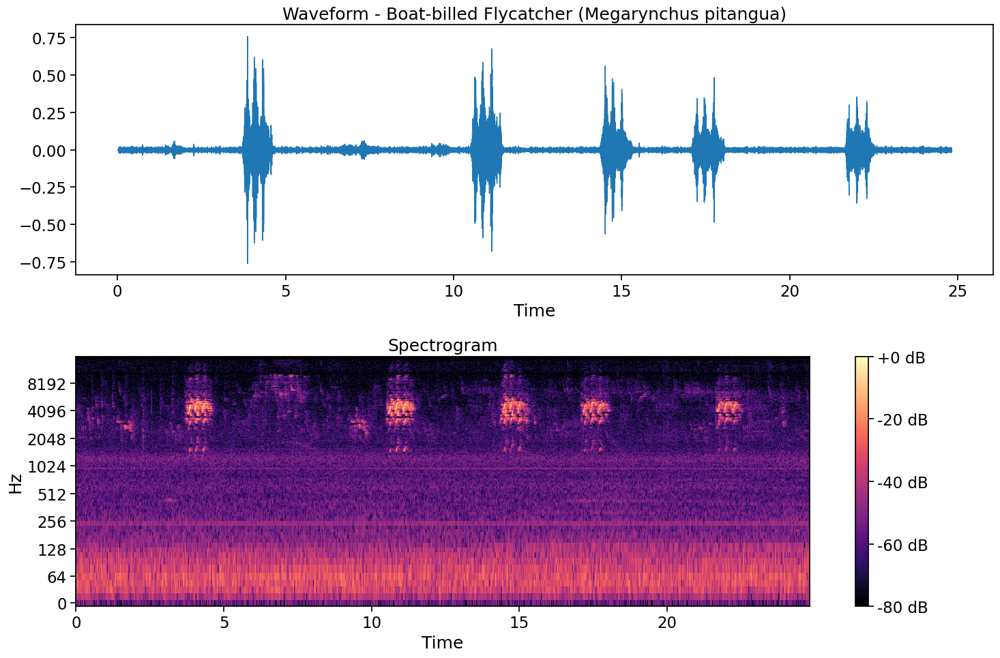

Species: Yellow-throated Toucan (Ramphastos ambiguus)
File: ../data/raw/train_audio/bkmtou1/iNat171420.ogg


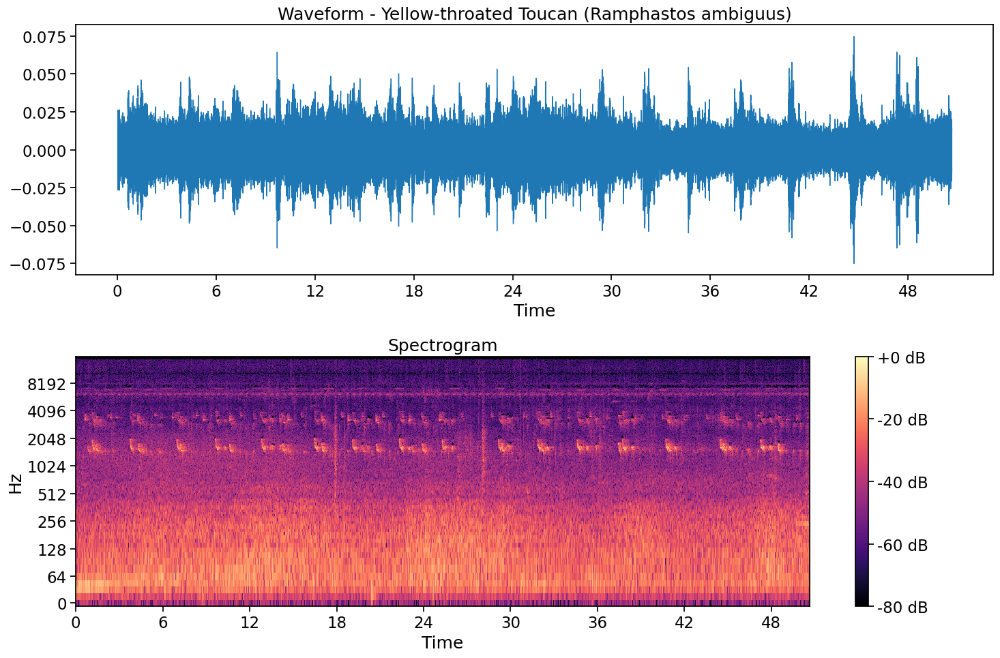

In [17]:
# sample audio files from each class
samples_per_class = 2

for class_name in taxonomy_df['class_name'].unique():
    print(f"\n--- Samples from {class_name} ---")

    # get recordings for this class
    class_recordings = train_with_taxonomy[train_with_taxonomy['class_name'] == class_name]

    # sample random recordings (if available)
    if len(class_recordings) > 0:
        samples = class_recordings.sample(min(samples_per_class, len(class_recordings)))

        for _, row in samples.iterrows():
            audio_path = TRAIN_AUDIO_DIR / row['filename']
            print(f"Species: {row['common_name']} ({row['scientific_name']})")
            print(f"File: {audio_path}")

            if os.path.exists(audio_path):
                y, sr = visualize_audio(audio_path, title=f"{row['common_name']} ({row['scientific_name']})")
                if y is not None:
                    display(Audio(y, rate=sr))
            else:
                print(f"File does not exist: {audio_path}")
    else:
        print("No recordings available for this class.")

## Analyze Recording Quality

Analyzing recording quality:


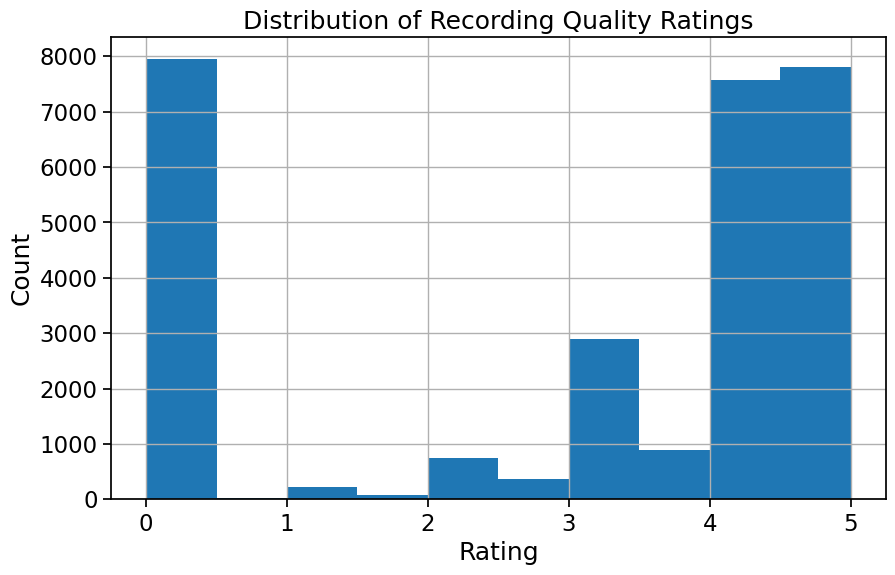

In [18]:
print('Analyzing recording quality:')
plt.figure(figsize=(10, 6))
train_df['rating'].hist(bins=10)
plt.title('Distribution of Recording Quality Ratings')
plt.xlabel('Rating')
plt.ylabel('Count')
plt.show()

## Analyze Geographic Distribution

Analyzing geographic distribution of recordings:


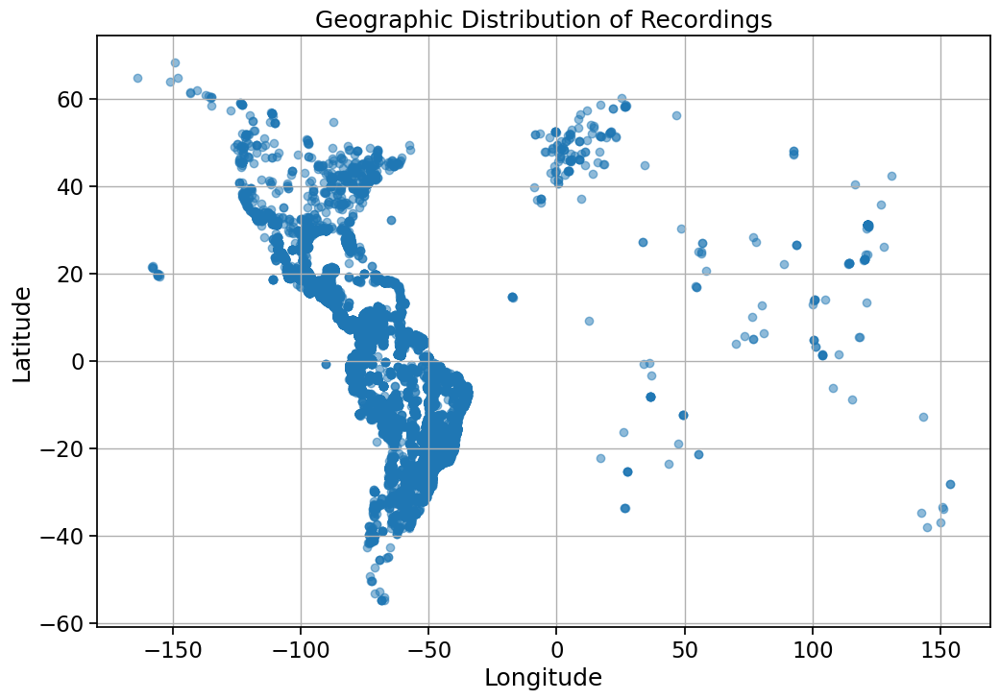

In [19]:
print('Analyzing geographic distribution of recordings:')
plt.figure(figsize=(12, 8))
valid_coords = train_df.dropna(subset=['latitude', 'longitude'])
plt.scatter(valid_coords['longitude'], valid_coords['latitude'], alpha=0.5)
plt.title('Geographic Distribution of Recordings')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()

## Examine Soundscape Files

In [20]:
print('Examining soundscape files:')
soundscape_files = list(TRAIN_SOUNDSCAPES_DIR.glob("*.ogg"))
print(f"Number of soundscape files: {len(soundscape_files)}")

Examining soundscape files:
Number of soundscape files: 9726


Visualizing sample soundscape: ../data/raw/train_soundscapes/H84_20230503_162500.ogg


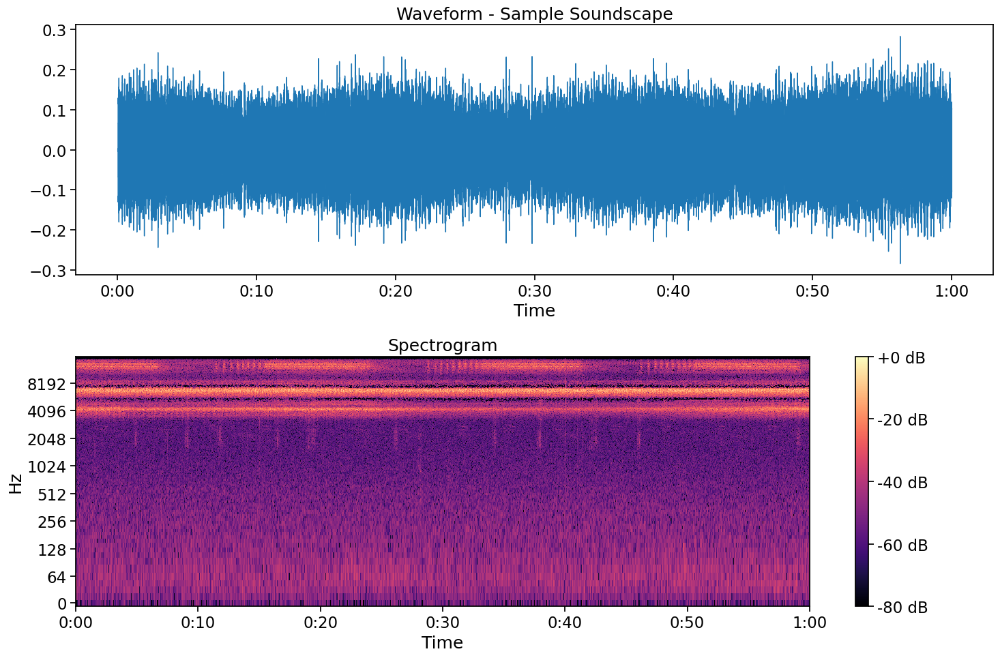

Playing first 10 seconds:


In [21]:
# sample a random soundscape
random_soundscape = random.choice(soundscape_files)
print(f"Visualizing sample soundscape: {random_soundscape}")
y, sr = visualize_audio(random_soundscape, title='Sample Soundscape')
if y is not None:
    print("Playing first 10 seconds:")
    display(Audio(y[:sr*10], rate=sr))